# Week 8 A
## Name: Jay Zhang
To solve the question: "What are the genetic factors related to Endometrioid Cancer when considering the influence of height?"

### 1. Data Preprocessing

In [1]:
!pip3 install sparse_lmm
!pip3 install statsmodels
!pip3 install pandas
!pip3 install numpy
!pip3 install seaborn


[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: pip3 install --upgrade pip

[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: pip3 install --upgrade pip

[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: pip3 install --upgrade pip

[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: pip3 install --upgrade pip

[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: pip3 install --upgrade pip


In [1]:
# Read file
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sparse_lmm import VariableSelection
clinical_data = pd.read_csv('/Users/kitkatj/Downloads/ai4science/TCGA dataset/TCGA_Endometrioid_Cancer_(UCEC)/TCGA.UCEC.sampleMap_UCEC_clinicalMatrix', sep='\t', index_col=0)
gene_data = pd.read_csv('/Users/kitkatj/Downloads/ai4science/TCGA dataset/TCGA_Endometrioid_Cancer_(UCEC)/TCGA.UCEC.sampleMap_HiSeqV2_PANCAN', sep='\t', index_col=0)
pd.options.display.max_columns = None

In [2]:
# Display clinical dataset
clinical_data.head()

,CDE_ID_3226963,_INTEGRATION,_PANCAN_CNA_PANCAN_K8,_PANCAN_Cluster_Cluster_PANCAN,_PANCAN_DNAMethyl_PANCAN,_PANCAN_DNAMethyl_UCEC,_PANCAN_RPPA_PANCAN_K8,_PANCAN_UNC_RNAseq_PANCAN_K16,_PANCAN_miRNA_PANCAN,_PANCAN_mirna_UCEC,_PANCAN_mutation_PANCAN,_PATIENT,_cohort,_primary_disease,_primary_site,additional_pharmaceutical_therapy,additional_radiation_therapy,additional_surgery_locoregional_procedure,additional_treatment_completion_success_outcome,age_at_initial_pathologic_diagnosis,aln_pos_ihc,aln_pos_light_micro,bcr_followup_barcode,bcr_patient_barcode,bcr_sample_barcode,birth_control_pill_history_usage_category,clinical_stage,colorectal_cancer,days_to_additional_surgery_metastatic_procedure,days_to_birth,days_to_collection,days_to_death,days_to_initial_pathologic_diagnosis,days_to_last_followup,days_to_last_known_alive,days_to_new_tumor_event_additional_surgery_procedure,days_to_new_tumor_event_after_initial_treatment,diabetes,disease_code,followup_case_report_form_submission_reason,form_completion_date,gender,height,histological_type,history_of_neoadjuvant_treatment,horm_ther,hypertension,icd_10,icd_o_3_histology,icd_o_3_site,informed_consent_verified,init_pathology_dx_method_other,initial_pathologic_diagnosis_method,initial_weight,is_ffpe,lost_follow_up,menopause_status,neoplasm_histologic_grade,new_neoplasm_event_occurrence_anatomic_site,new_neoplasm_event_type,new_neoplasm_occurrence_anatomic_site_text,new_tumor_event_additional_surgery_procedure,new_tumor_event_after_initial_treatment,oct_embedded,other_dx,pathology_report_file_name,patient_id,pct_tumor_invasion,peritoneal_wash,person_neoplasm_cancer_status,pln_pos_ihc,pln_pos_light_micro,postoperative_rx_tx,pregnancies,primary_therapy_outcome_success,prior_tamoxifen_administered_usage_category,project_code,radiation_therapy,recurrence_second_surgery_neoplasm_surgical_procedure_name,recurrence_second_surgery_neoplasm_surgical_procedure_name_other,residual_disease_post_new_tumor_event_margin_status,residual_tumor,sample_type,sample_type_id,surgical_approach,system_version,targeted_molecular_therapy,tissue_prospective_collection_indicator,tissue_retrospective_collection_indicator,tissue_source_site,total_aor_lnp,total_aor_lnr,total_pelv_lnp,total_pelv_lnr,tumor_tissue_site,vial_number,vital_status,weight,year_of_initial_pathologic_diagnosis,_GENOMIC_ID_TCGA_UCEC_exp_HiSeqV2_PANCAN,_GENOMIC_ID_data/public/TCGA/UCEC/miRNA_GA_gene,_GENOMIC_ID_TCGA_UCEC_PDMRNAseq,_GENOMIC_ID_TCGA_UCEC_exp_HiSeqV2_percentile,_GENOMIC_ID_TCGA_UCEC_RPPA_RBN,_GENOMIC_ID_TCGA_UCEC_RPPA,_GENOMIC_ID_TCGA_UCEC_PDMarrayCNV,_GENOMIC_ID_TCGA_UCEC_miRNA_GA,_GENOMIC_ID_TCGA_UCEC_exp_HiSeqV2_exon,_GENOMIC_ID_TCGA_UCEC_mutation_broad_gene,_GENOMIC_ID_TCGA_UCEC_mutation_wustl_gene,_GENOMIC_ID_TCGA_UCEC_mutation,_GENOMIC_ID_TCGA_UCEC_exp_HiSeqV2,_GENOMIC_ID_TCGA_UCEC_PDMarray,_GENOMIC_ID_TCGA_UCEC_miRNA_HiSeq,_GENOMIC_ID_TCGA_UCEC_exp_GAV2,_GENOMIC_ID_TCGA_UCEC_gistic2thd,_GENOMIC_ID_TCGA_UCEC_G4502A_07_3,_GENOMIC_ID_TCGA_UCEC_gistic2,_GENOMIC_ID_data/public/TCGA/UCEC/miRNA_HiSeq_gene,_GENOMIC_ID_TCGA_UCEC_PDMRNAseqCNV,_GENOMIC_ID_TCGA_UCEC_hMethyl450,_GENOMIC_ID_TCGA_UCEC_hMethyl27,_GENOMIC_ID_TCGA_UCEC_exp_GAV2_exon
sampleID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
TCGA-2E-A9G8-01,Indeterminate,TCGA-2E-A9G8-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TCGA-2E-A9G8,TCGA Endometrioid Cancer (UCEC),uterine corpus endometrioid carcinoma,Endometrium,YES,YES,NaN,Partial Response,59.0,0.0,0.0,TCGA-2E-A9G8-F66642,TCGA-2E-A9G8,TCGA-2E-A9G8-01A,Never Used,Stage III,NO,NaN,NaN,957.0,NaN,0.0,1249.0,NaN,NaN,396.0,NO,NaN,NaN,2014-10-21,FEMALE,157.0,Endometrioid endometrial adenocarcinoma,No,"No, I have never taken menopausal hormone ther...",NO,C54.3,8380/3,C54.3,YES,NaN,Office Endometrial Biopsy,90.0,NO,NO,Post (prior bilateral ovariectomy OR >12 mo si...,G2,"Other, specify",Locoregional Recurrence,port site,NaN,YES,False,Yes,TCGA-2E-A9G8.921E6140-

In [3]:
# Display gene dataset
gene_data.head()

,TCGA-A5-A2K7-01,TCGA-FL-A1YI-11,TCGA-EO-A3AS-01,TCGA-EY-A549-01,TCGA-EO-A3B0-01,TCGA-KJ-A3U4-01,TCGA-EY-A2OQ-01,TCGA-PG-A7D5-01,TCGA-B5-A0JN-01,TCGA-FL-A1YU-11,TCGA-EO-A3KW-01,TCGA-PG-A915-01,TCGA-D1-A3JQ-01,TCGA-AX-A2HH-01,TCGA-AJ-A5DV-01,TCGA-5S-A9Q8-01,TCGA-DI-A2QY-01,TCGA-DI-A1BU-01,TCGA-FL-A1YF-11,TCGA-B5-A5OE-01,TCGA-AX-A3G3-01,TCGA-PG-A916-01,TCGA-DI-A2QY-11,TCGA-AJ-A3NC-01,TCGA-FL-A1YG-11,TCGA-DF-A2KY-01,TCGA-AX-A3FV-01,TCGA-QS-A5YR-01,TCGA-DF-A2KZ-01,TCGA-A5-A2K2-01,TCGA-AX-A3FZ-01,TCGA-B5-A0JR-01,TCGA-AJ-A3TW-01,TCGA-PG-A914-01,TCGA-AX-A3GI-01,TCGA-D1-A2G0-01,TCGA-EY-A2OO-01,TCGA-A5-A7WJ-01,TCGA-AX-A3G9-01,TCGA-BK-A4ZD-01,TCGA-B5-A3FC-01,TCGA-AJ-A3NE-11,TCGA-AP-A3K1-01,TCGA-EY-A3QX-01,TCGA-AX-A0IZ-11,TCGA-AX-A05W-01,TCGA-AJ-A3BI-01,TCGA-EY-A2ON-01,TCGA-AX-A3FS-01,TCGA-SL-A6JA-01,TCGA-B5-A0K9-01,TCGA-AX-A2H4-01,TCGA-AJ-A3EJ-01,TCGA-AJ-A3NC-11,TCGA-EY-A1GP-01,TCGA-EO-A3KX-01,TCGA-AJ-A3BH-01,TCGA-D1-A3JP-01,TCGA-AJ-A3NF-01,TCGA-FI-A3PV-01,TCGA-AX-A05Y-11,TCGA-EY-A54A-01,TCGA-EO-A22U-01,TCGA-D1-A3DH-01,TCGA-FL-A1YQ-11,TCGA-SJ-A6ZI-01,TCGA-DF-A2KR-01,TCGA-AJ-A3NH-01,TCGA-EY-A1GL-01,TCGA-AX-A3G4-01,TCGA-SL-A6J9-01,TCGA-BG-A3EW-01,TCGA-A5-A2K3-01,TCGA-B5-A5OD-01,TCGA-B5-A5OC-01,TCGA-EY-A1GX-01,TCGA-E6-A8L9-01,TCGA-BG-A0MK-01,TCGA-AX-A3GB-01,TCGA-E6-A2P8-01,TCGA-QF-A5YT-01,TCGA-5B-A90C-01,TCGA-AJ-A3OK-01,TCGA-AX-A3G1-01,TCGA-SJ-A6ZJ-01,TCGA-K6-A3WQ-01,TCGA-EY-A3L3-01,TCGA-AJ-A3BK-01,TCGA-KP-A3W0-01,TCGA-AX-A2IN-01,TCGA-BG-A2AD-11,TCGA-AJ-A3QS-01,TCGA-EY-A210-01,TCGA-DI-A1C3-01,TCGA-AJ-A3EL-01,TCGA-AX-A2HC-11,TCGA-A5-A3LP-01,TCGA-FL-A1YT-11,TCGA-EO-A22Y-01,TCGA-AX-A3FT-01,TCGA-A5-A2K5-01,TCGA-DF-A2KN-01,TCGA-AJ-A2QM-01,TCGA-AX-A3FX-01,TCGA-AJ-A3I9-01,TCGA-AJ-A3EM-01,TCGA-FL-A1YH-11,TCGA-KP-A3W4-01,TCGA-PG-A5BC-01,TCGA-B5-A3FD-01,TCGA-E6-A2P9-01,TCGA-B5-A3FB-01,TCGA-QS-A8F1-01,TCGA-FI-A2EY-01,TCGA-BK-A139-02,TCGA-EO-A3KU-01,TCGA-B5-A11R-01,TCGA-B5-A1MS-01,TCGA-A5-A3LO-01,TCGA-KP-A3W1-01,TCGA-A5-A1OH-01,TCGA-AJ-A3OJ-01,TCGA-A5-A2K4-01,TCGA-AJ-A2QO-01,TCGA-AJ-A3NH-11,TCGA-EY-A4KR-01,TCGA-BG-A3PP-01,TCGA-AX-A1C7-01,TCGA-AX-A0J0-11,TCGA-BK-A4ZD-11,TCGA-A5-A7WK-01,TCGA-AX-A3FW-01,TCGA-AJ-A8CV-01,TCGA-AP-A5FX-01,TCGA-JU-AAVI-01,TCGA-EO-A3AZ-01,TCGA-DF-A2KU-01,TCGA-BS-A0V7-01,TCGA-BK-A6W4-01,TCGA-FL-A1YL-11,TCGA-EO-A1Y7-01,TCGA-BK-A13B-01,TCGA-QS-A5YQ-01,TCGA-EO-A3AU-01,TCGA-AJ-A3NE-01,TCGA-BG-A3PP-11,TCGA-B5-A3FH-01,TCGA-AX-A2HD-11,TCGA-B5-A3FA-01,TCGA-AX-A3G8-01,TCGA-A5-AB3J-01,TCGA-DF-A2L0-01,TCGA-4E-A92E-01,TCGA-AJ-A3BF-01,TCGA-EY-A2OP-01,TCGA-AJ-A23N-01,TCGA-FL-A1YN-11,TCGA-QS-A744-01,TCGA-2E-A9G8-01,TCGA-PG-A6IB-01,TCGA-AJ-A3BG-01,TCGA-EO-A3AV-01,TCGA-B5-A3F9-01,TCGA-QF-A5YS-01,TCGA-EY-A72D-01,TCGA-AJ-A5DW-01,TCGA-AX-A3G7-01,TCGA-AJ-A6NU-01,TCGA-EO-A3L0-01,TCGA-AX-A3G6-01,TCGA-B5-A1MW-01,TCGA-FI-A3PX-01,TCGA-D1-A3DG-01,TCGA-EY-A1GO-01,TCGA-BS-A0V4-01,TCGA-AJ-A3OL-01,TCGA-FL-A3WE-11,TCGA-BG-A3EW-11,TCGA-AJ-A3NG-01,TCGA-AJ-A8CT-01,TCGA-EY-A5W2-01,TCGA-DI-A2QT-01,TCGA-KP-A3VZ-01,TCGA-EY-A548-01,TCGA-B5-A3S1-01,TCGA-PG-A917-01,TCGA-EO-A3B1-01,TCGA-AJ-A3BD-01,TCGA-DF-A2KV-01,TCGA-EO-A22X-01,TCGA-AJ-A3EK-01,TCGA-D1-A3DA-01,TCGA-KP-A3W3-01,TCGA-AJ-A3IA-01,TCGA-AJ-A8CW-01,TCGA-H5-A2HR-01,TCGA-EY-A547-01,TCGA-FL-A1YV-11,TCGA-BK-A6W3-01,TCGA-BK-A56F-01,TCGA-EO-A3AY-01
sample,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
ARHGEF10L,-1.033992,0.180208,-0.826192,-0.736292,-2.025392,-0.081192,-1.068392,-1.211492,-0.320192,-0.429692,-1.169492,-0.463592,-1.393092,-0.201992,-0.136892,-0.907792,-0.689492,0.027208,0.062608,0.798708,-0.939092,-1.029792,0.119108,0.182808,-0.924592,-1.952992,0.827408,-0.064892,0.158008,0.298608,-1.679992,-1.955992,-0.369892,-1.579892,0.122708,-1.271892,0.108008,0.331708,-0.817392,-4.570392,-1.038792,-0.816492,0.050108,1.055608,-0.675692,0.410508,-1.998292,0.649708,-1.694892,-0.312692,0.352108,-0.595892,-1.155692,-0.559092,-0.269292,-1.502892,1.000208,-0.799292,0.0

In [4]:
# Set Basic info
trait = 'Endometrioid Cancer'
condition = 'height'
condition_col = 'height'
gene_list = gene_data.index.tolist()
# Get the feature dimension of clinical data, and the number of genes
col_offset = len(clinical_data.columns)
num_genes = len(gene_list)
print(f'The clinical dataset has {col_offset} features, and the gene dataset includes {num_genes} genes')

The clinical dataset has 123 features, and the gene dataset includes 20530 genes


In [5]:
# Merge clinical_data and gene_data on their indices - sample_ID, corresponding to each person
merged_data = clinical_data.join(gene_data.T)
merged_data.head()

,CDE_ID_3226963,_INTEGRATION,_PANCAN_CNA_PANCAN_K8,_PANCAN_Cluster_Cluster_PANCAN,_PANCAN_DNAMethyl_PANCAN,_PANCAN_DNAMethyl_UCEC,_PANCAN_RPPA_PANCAN_K8,_PANCAN_UNC_RNAseq_PANCAN_K16,_PANCAN_miRNA_PANCAN,_PANCAN_mirna_UCEC,_PANCAN_mutation_PANCAN,_PATIENT,_cohort,_primary_disease,_primary_site,additional_pharmaceutical_therapy,additional_radiation_therapy,additional_surgery_locoregional_procedure,additional_treatment_completion_success_outcome,age_at_initial_pathologic_diagnosis,aln_pos_ihc,aln_pos_light_micro,bcr_followup_barcode,bcr_patient_barcode,bcr_sample_barcode,birth_control_pill_history_usage_category,clinical_stage,colorectal_cancer,days_to_additional_surgery_metastatic_procedure,days_to_birth,days_to_collection,days_to_death,days_to_initial_pathologic_diagnosis,days_to_last_followup,days_to_last_known_alive,days_to_new_tumor_event_additional_surgery_procedure,days_to_new_tumor_event_after_initial_treatment,diabetes,disease_code,followup_case_report_form_submission_reason,form_completion_date,gender,height,histological_type,history_of_neoadjuvant_treatment,horm_ther,hypertension,icd_10,icd_o_3_histology,icd_o_3_site,informed_consent_verified,init_pathology_dx_method_other,initial_pathologic_diagnosis_method,initial_weight,is_ffpe,lost_follow_up,menopause_status,neoplasm_histologic_grade,new_neoplasm_event_occurrence_anatomic_site,new_neoplasm_event_type,new_neoplasm_occurrence_anatomic_site_text,new_tumor_event_additional_surgery_procedure,new_tumor_event_after_initial_treatment,oct_embedded,other_dx,pathology_report_file_name,patient_id,pct_tumor_invasion,peritoneal_wash,person_neoplasm_cancer_status,pln_pos_ihc,pln_pos_light_micro,postoperative_rx_tx,pregnancies,primary_therapy_outcome_success,prior_tamoxifen_administered_usage_category,project_code,radiation_therapy,recurrence_second_surgery_neoplasm_surgical_procedure_name,recurrence_second_surgery_neoplasm_surgical_procedure_name_other,residual_disease_post_new_tumor_event_margin_status,residual_tumor,sample_type,sample_type_id,surgical_approach,system_version,targeted_molecular_therapy,tissue_prospective_collection_indicator,tissue_retrospective_collection_indicator,tissue_source_site,total_aor_lnp,total_aor_lnr,total_pelv_lnp,total_pelv_lnr,tumor_tissue_site,vial_number,vital_status,weight,year_of_initial_pathologic_diagnosis,_GENOMIC_ID_TCGA_UCEC_exp_HiSeqV2_PANCAN,_GENOMIC_ID_data/public/TCGA/UCEC/miRNA_GA_gene,_GENOMIC_ID_TCGA_UCEC_PDMRNAseq,_GENOMIC_ID_TCGA_UCEC_exp_HiSeqV2_percentile,_GENOMIC_ID_TCGA_UCEC_RPPA_RBN,_GENOMIC_ID_TCGA_UCEC_RPPA,_GENOMIC_ID_TCGA_UCEC_PDMarrayCNV,_GENOMIC_ID_TCGA_UCEC_miRNA_GA,_GENOMIC_ID_TCGA_UCEC_exp_HiSeqV2_exon,_GENOMIC_ID_TCGA_UCEC_mutation_broad_gene,_GENOMIC_ID_TCGA_UCEC_mutation_wustl_gene,_GENOMIC_ID_TCGA_UCEC_mutation,_GENOMIC_ID_TCGA_UCEC_exp_HiSeqV2,_GENOMIC_ID_TCGA_UCEC_PDMarray,_GENOMIC_ID_TCGA_UCEC_miRNA_HiSeq,_GENOMIC_ID_TCGA_UCEC_exp_GAV2,_GENOMIC_ID_TCGA_UCEC_gistic2thd,_GENOMIC_ID_TCGA_UCEC_G4502A_07_3,_GENOMIC_ID_TCGA_UCEC_gistic2,_GENOMIC_ID_data/public/TCGA/UCEC/miRNA_HiSeq_gene,_GENOMIC_ID_TCGA_UCEC_PDMRNAseqCNV,_GENOMIC_ID_TCGA_UCEC_hMethyl450,_GENOMIC_ID_TCGA_UCEC_hMethyl27,_GENOMIC_ID_TCGA_UCEC_exp_GAV2_exon,ARHGEF10L,HIF3A,RNF17,RNF10,RNF11,RNF13,GTF2IP1,REM1,MTVR2,RTN4RL2,C16orf13,C16orf11,FGFR1OP2,TSKS,ATRX,PMM2,LOC100272146,ASS1,NCBP1,ZNF709,ZNF708,RBM14,NCBP2,DISC1,CAMK1,RPL37,SPR,ZNF700,ZNF707,CAMK4,ZNF704,LOC339240,GOLGA6B,RNF115,RNF112,ZC3H14,SPN,HMGCLL1,NACAP1,LRRTM1,GRIN1,RBMY1A3P,DHX8,DHX9,LOC441204,TCOF1,LRRTM3,NUP98,XPC,SLC12A2,GRINA,LRRTM2,NUP93,HAP1,KLRA1,CAMKV,SPPL3,GOLIM4,ZNF646,OPA3,OPA1,RHEB,RAB40C,RAB40B,RAB40A,COL7A1,MDP1,GTSE1,FAM183A,ARFRP1,OVCH1,FAM183B,PSAP,KIAA0831,SPPL2A,SLC46A1,TGFBR2,ITGA8,ITGA9,STK40,MYO3B,ATP2A1,ATP2A2,ATP2A3,ITGA1,ITGA2,ITGA3,ITGA4,ITGA5,ITGA6,ITGA7,TRHR,LOC100132288,DENND4A,DENND4B,DENND4C,SWAP70,RARRES1,LOC100132287,PHLDA3,PHLDA2,TACO1,PMM1,GAP43,NENF,SQLE,MRPL28,LOC100289341,FBXL13,FBXL12,FBXL15,CYP27B1,FBXL17,FBXL16,FAM169A,FAM116B,FAM116A,FAM169B,RA

In [6]:
# Only select relevant columns
feature_cols = [condition_col] + gene_list
merged_data = merged_data[feature_cols]

# Remove sample rows with missing columns.
threshold_rows = 0.8 * len(merged_data)
rows_after_any = len(merged_data.dropna(how='any'))

# Prefer "how='any'", if it does not discard too much data.
if rows_after_any >= threshold_rows:
    merged_data = merged_data.dropna(how='any')
else:
    merged_data = merged_data.dropna(how='all')
    merged_data = merged_data.fillna(0)

# delete all 0 value entrance
merged_data = merged_data.loc[merged_data[condition_col] != 0]
merged_data.head()

,height,ARHGEF10L,HIF3A,RNF17,RNF10,RNF11,RNF13,GTF2IP1,REM1,MTVR2,RTN4RL2,C16orf13,C16orf11,FGFR1OP2,TSKS,ATRX,PMM2,LOC100272146,ASS1,NCBP1,ZNF709,ZNF708,RBM14,NCBP2,DISC1,CAMK1,RPL37,SPR,ZNF700,ZNF707,CAMK4,ZNF704,LOC339240,GOLGA6B,RNF115,RNF112,ZC3H14,SPN,HMGCLL1,NACAP1,LRRTM1,GRIN1,RBMY1A3P,DHX8,DHX9,LOC441204,TCOF1,LRRTM3,NUP98,XPC,SLC12A2,GRINA,LRRTM2,NUP93,HAP1,KLRA1,CAMKV,SPPL3,GOLIM4,ZNF646,OPA3,OPA1,RHEB,RAB40C,RAB40B,RAB40A,COL7A1,MDP1,GTSE1,FAM183A,ARFRP1,OVCH1,FAM183B,PSAP,KIAA0831,SPPL2A,SLC46A1,TGFBR2,ITGA8,ITGA9,STK40,MYO3B,ATP2A1,ATP2A2,ATP2A3,ITGA1,ITGA2,ITGA3,ITGA4,ITGA5,ITGA6,ITGA7,TRHR,LOC100132288,DENND4A,DENND4B,DENND4C,SWAP70,RARRES1,LOC100132287,PHLDA3,PHLDA2,TACO1,PMM1,GAP43,NENF,SQLE,MRPL28,LOC100289341,FBXL13,FBXL12,FBXL15,CYP27B1,FBXL17,FBXL16,FAM169A,FAM116B,FAM116A,FAM169B,RALGAPA2,GHDC,H19,SDK2,GRP,TPRN,THSD4,KIAA0895L,CHST9,CHST8,COL4A5,COL4A4,COL4A3,COL4A2,COL4A1,SLC35D2,CHST1,ZNF879,CHST3,CHST2,CHST5,CHST4,CHST7,CHST6,ITGAX,OR8J1,SNORD115-17,BCL2A1,GPSM2,HLCS,NOG,LIPG,ITGAV,HIBCH,ZNF703,ITGAL,ITGAM,LOC286359,HLF,NOV,FAM134C,FAM134B,FAM134A,SERPING1,SMAD9,TRERF1,LOC653501,LRPAP1,LQK1,SMAD6,SMAD7,GOLPH3L,SMAD1,AFTPH,SMAD3,MUS81,AMMECR1L,IL1RAPL1,TMPRSS11B,IGF2R,TMPRSS11D,TMPRSS11F,ZC3H10,RAD21L1,IL1RAPL2,SLC36A3,CKS1B,SLC36A1,ST13,RPL31P11,C14orf115,ZC3H15,TMEM213,C14orf118,ARTN,ART1,HRH3,ART3,HERC2P2,ART5,ART4,RNF111,TCEA2,TCEA3,TCEA1,MGC57346,COX4I2,COX4I1,BFAR,ZC3H18,TMEM212,SNORD115-13,TCEB3B,SIPA1,CRTAM,EDA,OR6P1,CCDC116,CADPS2,CCDC114,CCDC115,CCDC112,CCDC113,CCDC110,CCDC111,LEO1,ATP1A4,ATP1A3,ATP1A2,ATP1A1,KGFLP2,MGRN1,TCP1,CRTAP,CBLC,SPHK1,DPT,BPESC1,CUEDC1,CUEDC2,CBLB,CPEB4,CPEB1,ZNF45,CPEB3,CPEB2,BEGAIN,RBMXL3,OSGEP,ABAT,LOC100129637,ZNF780A,ZNF780B,TLN2,FRG1,FRG2,RHEBL1,ZNF41,IFT80,FBRS,ZNF414,IFT88,IL10RA,POU5F1B,SP1,SLC27A4,SP2,OLA1,PNOC,CNTF,MCM10,PDIA5,SP4,TMEM38B,THUMPD3,IGFBPL1,SP5,ATG4C,ATG4B,ATG4A,THUMPD2,LOC441208,ATG4D,PHOX2A,PHOX2B,SNORD114-31,SNORD114-30,LRGUK,MPHOSPH8,UPK2,CFH,CFI,PNP,ANKFY1,C1orf14,CFB,OR5P3,OR5P2,MLLT4,SNORD115-6,CREBBP,PNN,PHYHIPL,ATP6V0E1,ATP6V0E2,RNF128,CFP,AAAS,HAMP,ZNF394,SIDT1,SERPINA10,SIDT2,SNORD115-7,TAF8,PISRT1,SIX4,LOC283070,SIX6,PM20D1,MR1,MGC4473,SIX3,SNORD115-4,WASH3P,CNPY4,CNPY3,CNPY2,CNPY1,NODAL,SYNJ1,KNDC1,HMG20A,HMG20B,PHOSPHO2,AAGAB,C4orf19,C3orf79,SLC7A6OS,C3orf77,C3orf75,C3orf74,C4orf10,C3orf72,C3orf71,C3orf70,ZNF285,MRO,ZFP82,CHFR,EFHA1,RTBDN,EFHA2,AAA1,GPR75,NUDT9P1,SYPL2,RFX8,ZNF222,RFX4,OR2C3,AVPR2,RFX7,NRXN3,GPR77,NRXN1,RFX3,SNORD104,RFPL2,VPS37D,NLRP13,APC,TMEM179B,ABCE1,UQCRC2,XPNPEP1,XPNPEP2,TIGD4,ZNHIT3,GGCX,PAPLN,ADNP,TMEM218,STXBP6,KHDRBS1,RUNDC2C,KHDRBS3,GGCT,VPS37C,STAC2,LOC283404,ZNF395,STAC3,TBL1Y,LHCGR,TMEM211,OR1Q1,TMEM127,GPR78,TRPA1,VPS37B,TTC7A,UQCRHL,ZBED4,C11orf2,C11orf1,DPYSL5,DPYSL2,DPYSL3,OSTM1,RUNX2,C11orf9,KRTAP10-12,KRTAP10-11,KRTAP10-10,IGFBP2,IGFBP3,IGFBP1,BOP1,IGFBP7,IGFBP4,IGFBP5,SKP2,TTC4,CYP2R1,CKLF,ZNF193,C15orf26,C15orf27,C15orf24,GJA3,APLNR,C15orf23,C15orf21,GJA8,CYP8B1,C15orf28,C15orf29,STMN1,S1PR2,KDM3B,REG1P,STK17A,KDM3A,LOC401387,S1PR1,ZNF642,TMC4,MYO3A,TMC6,KIAA1958,APIP,TMC1,GPR15,TMC3,PKLR,TECRL,EIF2B4,EIF2B5,EIF2B2,EIF2B3,EIF2B1,PRKAR2A,CSNK2A1P,XRRA1,C20orf56,C20orf54,TXNIP,SLC36A4,LOC389791,ZNF876P,MLF1,QPRT,IFT140,MLF2,TMEM14C,FAM157A,FAM157B,FANCF,MECOM,ITGA2B,RSPH1,IFI16,SOX6,LOC440944,TTC1,C9orf128,C9orf129,MYT1L,C9orf125,C9orf122,CEPT1,KIAA1267,RTCD1,CFHR2,CFHR3,CLIC4,CLIC5,CLIC2,CLIC3,CFHR4,CFHR5,KRTAP2-2,KRTAP2-1,CXorf1,KIAA0020,KRTAP2-4,TMEM147,ASGR1,ASGR2,PCDHA1,FOXL2,RIT1,TMEM141,FOXL1,SF1,PCDHA6,PKIB,TMEM149,API5,KRTCAP3,NUMBL,RTKN2,RNF180,P2RX7,SECISBP2L,SBF1P1,LOC100128811,HAS2,KIAA1199,HLA-DPA1,ZSWIM3,FAM32A,KIAA1191,FER1L6,ALOX12P2,FER1L4,FER1L5,CA5B,ZNF559,VWA1,C19orf22,C19orf23,C19orf20,C19orf21,C19orf26,ZMAT4,C19orf24,C19orf25,MYBL1,NR1D1,C19orf28,C19orf29,ITGB1BP1,ITGB1BP3,ITGB1BP2,ZNF7,ZNF2,ZNF3,CTCFL,PHLDA1,RPL31,ZNF8,PCP4L1,C11orf17,C11orf16,ZAP70,SNORD115-9,C11orf10,ZCCHC13,UFSP2,OGFR,EPM2AIP1,CDC5L,RAC2,RAC3,RAC1,SBDS,RCL1,SBK2,MRPS18A,CPLX2,CPLX3,ORC3L,CPLX1,AP2

In [7]:
# Decode the trait information from Sample IDs. Tumor types range from 01 - 09, normal types from 10 - 19.
# Create a function to check the last two digits of a row index

def mark_tumor(row_index):
    last_two_digits = int(row_index[-2:])
    
    mapping = {
        (1, 9): 1,
        (10, 19): 0
    }
    
    return next((value for (start, end), value in mapping.items() if start <= last_two_digits <= end), -1)


# Use the apply function to add the trait column to merged_data
merged_data[trait] = merged_data.index.to_series().apply(mark_tumor)

merged_data.head()

,height,ARHGEF10L,HIF3A,RNF17,RNF10,RNF11,RNF13,GTF2IP1,REM1,MTVR2,RTN4RL2,C16orf13,C16orf11,FGFR1OP2,TSKS,ATRX,PMM2,LOC100272146,ASS1,NCBP1,ZNF709,ZNF708,RBM14,NCBP2,DISC1,CAMK1,RPL37,SPR,ZNF700,ZNF707,CAMK4,ZNF704,LOC339240,GOLGA6B,RNF115,RNF112,ZC3H14,SPN,HMGCLL1,NACAP1,LRRTM1,GRIN1,RBMY1A3P,DHX8,DHX9,LOC441204,TCOF1,LRRTM3,NUP98,XPC,SLC12A2,GRINA,LRRTM2,NUP93,HAP1,KLRA1,CAMKV,SPPL3,GOLIM4,ZNF646,OPA3,OPA1,RHEB,RAB40C,RAB40B,RAB40A,COL7A1,MDP1,GTSE1,FAM183A,ARFRP1,OVCH1,FAM183B,PSAP,KIAA0831,SPPL2A,SLC46A1,TGFBR2,ITGA8,ITGA9,STK40,MYO3B,ATP2A1,ATP2A2,ATP2A3,ITGA1,ITGA2,ITGA3,ITGA4,ITGA5,ITGA6,ITGA7,TRHR,LOC100132288,DENND4A,DENND4B,DENND4C,SWAP70,RARRES1,LOC100132287,PHLDA3,PHLDA2,TACO1,PMM1,GAP43,NENF,SQLE,MRPL28,LOC100289341,FBXL13,FBXL12,FBXL15,CYP27B1,FBXL17,FBXL16,FAM169A,FAM116B,FAM116A,FAM169B,RALGAPA2,GHDC,H19,SDK2,GRP,TPRN,THSD4,KIAA0895L,CHST9,CHST8,COL4A5,COL4A4,COL4A3,COL4A2,COL4A1,SLC35D2,CHST1,ZNF879,CHST3,CHST2,CHST5,CHST4,CHST7,CHST6,ITGAX,OR8J1,SNORD115-17,BCL2A1,GPSM2,HLCS,NOG,LIPG,ITGAV,HIBCH,ZNF703,ITGAL,ITGAM,LOC286359,HLF,NOV,FAM134C,FAM134B,FAM134A,SERPING1,SMAD9,TRERF1,LOC653501,LRPAP1,LQK1,SMAD6,SMAD7,GOLPH3L,SMAD1,AFTPH,SMAD3,MUS81,AMMECR1L,IL1RAPL1,TMPRSS11B,IGF2R,TMPRSS11D,TMPRSS11F,ZC3H10,RAD21L1,IL1RAPL2,SLC36A3,CKS1B,SLC36A1,ST13,RPL31P11,C14orf115,ZC3H15,TMEM213,C14orf118,ARTN,ART1,HRH3,ART3,HERC2P2,ART5,ART4,RNF111,TCEA2,TCEA3,TCEA1,MGC57346,COX4I2,COX4I1,BFAR,ZC3H18,TMEM212,SNORD115-13,TCEB3B,SIPA1,CRTAM,EDA,OR6P1,CCDC116,CADPS2,CCDC114,CCDC115,CCDC112,CCDC113,CCDC110,CCDC111,LEO1,ATP1A4,ATP1A3,ATP1A2,ATP1A1,KGFLP2,MGRN1,TCP1,CRTAP,CBLC,SPHK1,DPT,BPESC1,CUEDC1,CUEDC2,CBLB,CPEB4,CPEB1,ZNF45,CPEB3,CPEB2,BEGAIN,RBMXL3,OSGEP,ABAT,LOC100129637,ZNF780A,ZNF780B,TLN2,FRG1,FRG2,RHEBL1,ZNF41,IFT80,FBRS,ZNF414,IFT88,IL10RA,POU5F1B,SP1,SLC27A4,SP2,OLA1,PNOC,CNTF,MCM10,PDIA5,SP4,TMEM38B,THUMPD3,IGFBPL1,SP5,ATG4C,ATG4B,ATG4A,THUMPD2,LOC441208,ATG4D,PHOX2A,PHOX2B,SNORD114-31,SNORD114-30,LRGUK,MPHOSPH8,UPK2,CFH,CFI,PNP,ANKFY1,C1orf14,CFB,OR5P3,OR5P2,MLLT4,SNORD115-6,CREBBP,PNN,PHYHIPL,ATP6V0E1,ATP6V0E2,RNF128,CFP,AAAS,HAMP,ZNF394,SIDT1,SERPINA10,SIDT2,SNORD115-7,TAF8,PISRT1,SIX4,LOC283070,SIX6,PM20D1,MR1,MGC4473,SIX3,SNORD115-4,WASH3P,CNPY4,CNPY3,CNPY2,CNPY1,NODAL,SYNJ1,KNDC1,HMG20A,HMG20B,PHOSPHO2,AAGAB,C4orf19,C3orf79,SLC7A6OS,C3orf77,C3orf75,C3orf74,C4orf10,C3orf72,C3orf71,C3orf70,ZNF285,MRO,ZFP82,CHFR,EFHA1,RTBDN,EFHA2,AAA1,GPR75,NUDT9P1,SYPL2,RFX8,ZNF222,RFX4,OR2C3,AVPR2,RFX7,NRXN3,GPR77,NRXN1,RFX3,SNORD104,RFPL2,VPS37D,NLRP13,APC,TMEM179B,ABCE1,UQCRC2,XPNPEP1,XPNPEP2,TIGD4,ZNHIT3,GGCX,PAPLN,ADNP,TMEM218,STXBP6,KHDRBS1,RUNDC2C,KHDRBS3,GGCT,VPS37C,STAC2,LOC283404,ZNF395,STAC3,TBL1Y,LHCGR,TMEM211,OR1Q1,TMEM127,GPR78,TRPA1,VPS37B,TTC7A,UQCRHL,ZBED4,C11orf2,C11orf1,DPYSL5,DPYSL2,DPYSL3,OSTM1,RUNX2,C11orf9,KRTAP10-12,KRTAP10-11,KRTAP10-10,IGFBP2,IGFBP3,IGFBP1,BOP1,IGFBP7,IGFBP4,IGFBP5,SKP2,TTC4,CYP2R1,CKLF,ZNF193,C15orf26,C15orf27,C15orf24,GJA3,APLNR,C15orf23,C15orf21,GJA8,CYP8B1,C15orf28,C15orf29,STMN1,S1PR2,KDM3B,REG1P,STK17A,KDM3A,LOC401387,S1PR1,ZNF642,TMC4,MYO3A,TMC6,KIAA1958,APIP,TMC1,GPR15,TMC3,PKLR,TECRL,EIF2B4,EIF2B5,EIF2B2,EIF2B3,EIF2B1,PRKAR2A,CSNK2A1P,XRRA1,C20orf56,C20orf54,TXNIP,SLC36A4,LOC389791,ZNF876P,MLF1,QPRT,IFT140,MLF2,TMEM14C,FAM157A,FAM157B,FANCF,MECOM,ITGA2B,RSPH1,IFI16,SOX6,LOC440944,TTC1,C9orf128,C9orf129,MYT1L,C9orf125,C9orf122,CEPT1,KIAA1267,RTCD1,CFHR2,CFHR3,CLIC4,CLIC5,CLIC2,CLIC3,CFHR4,CFHR5,KRTAP2-2,KRTAP2-1,CXorf1,KIAA0020,KRTAP2-4,TMEM147,ASGR1,ASGR2,PCDHA1,FOXL2,RIT1,TMEM141,FOXL1,SF1,PCDHA6,PKIB,TMEM149,API5,KRTCAP3,NUMBL,RTKN2,RNF180,P2RX7,SECISBP2L,SBF1P1,LOC100128811,HAS2,KIAA1199,HLA-DPA1,ZSWIM3,FAM32A,KIAA1191,FER1L6,ALOX12P2,FER1L4,FER1L5,CA5B,ZNF559,VWA1,C19orf22,C19orf23,C19orf20,C19orf21,C19orf26,ZMAT4,C19orf24,C19orf25,MYBL1,NR1D1,C19orf28,C19orf29,ITGB1BP1,ITGB1BP3,ITGB1BP2,ZNF7,ZNF2,ZNF3,CTCFL,PHLDA1,RPL31,ZNF8,PCP4L1,C11orf17,C11orf16,ZAP70,SNORD115-9,C11orf10,ZCCHC13,UFSP2,OGFR,EPM2AIP1,CDC5L,RAC2,RAC3,RAC1,SBDS,RCL1,SBK2,MRPS18A,CPLX2,CPLX3,ORC3L,CPLX1,AP2

### 2. Preliminary analysis

Plot the distributions of the target and important regressors

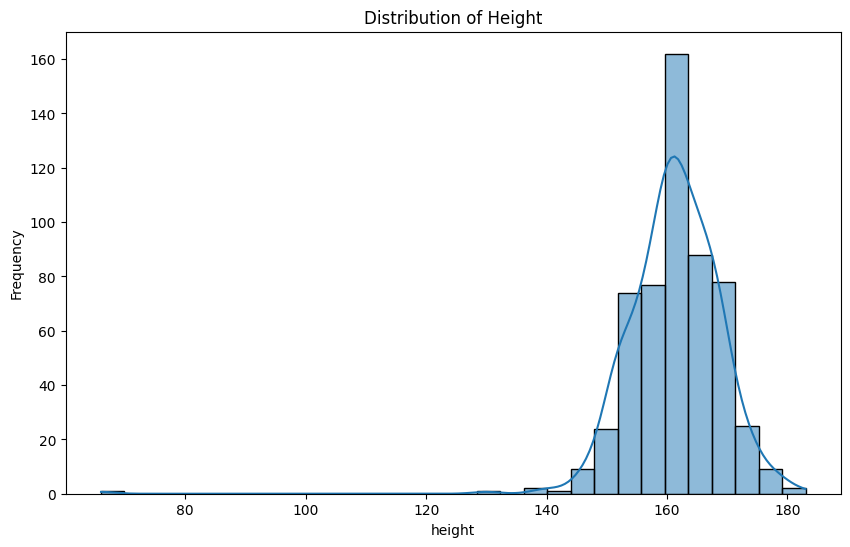

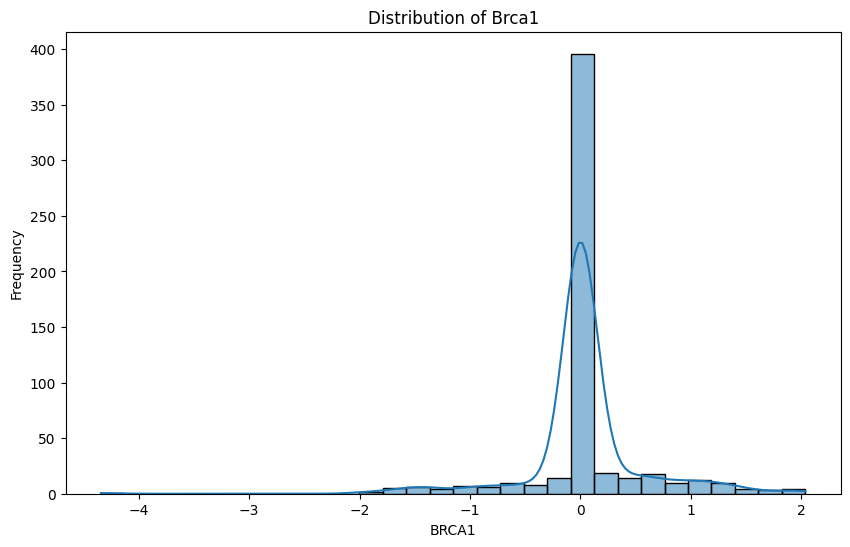

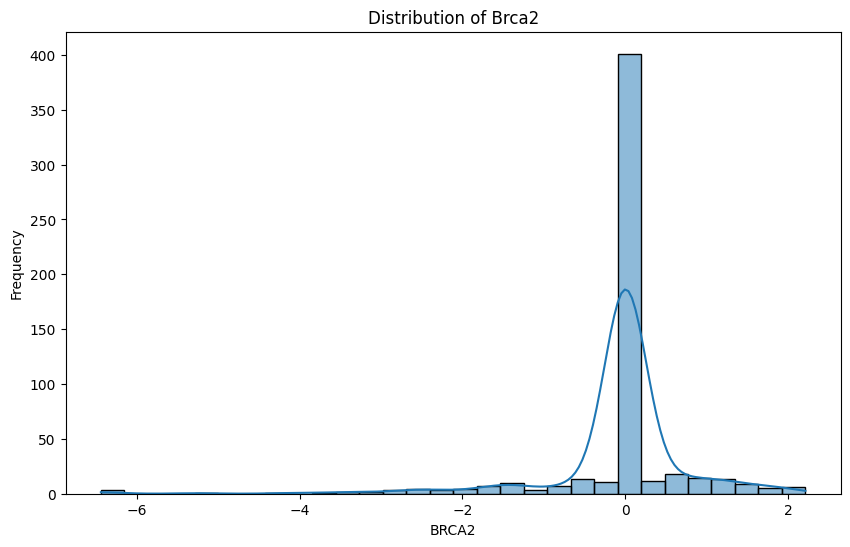

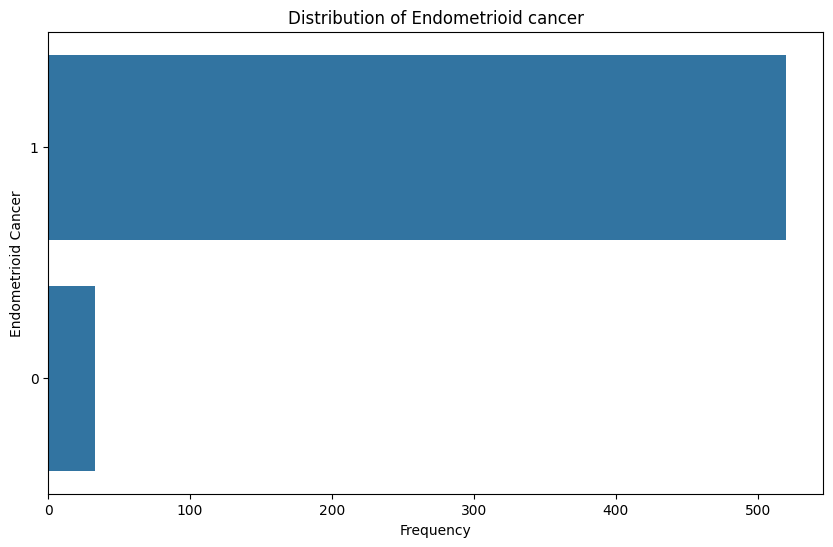

In [8]:
class DataVisualizer:
    def __init__(self, df):
        self.df = df

    def plot_distribution(self, column, numeric=True):
        plt.figure(figsize=(10, 6))
        if numeric:
            sns.histplot(self.df[column], kde=True, bins=30)
            plt.ylabel('Frequency')
        else:
            sns.countplot(y=column, data=self.df, order=self.df[column].value_counts().index)
            plt.xlabel('Frequency')
        plt.title(f'Distribution of {column.capitalize()}')
        plt.show()

    def analyze_distributions(self, numerical_columns, categorical_columns):
        for col in numerical_columns:
            self.plot_distribution(col, numeric=True)

        for col in categorical_columns:
            self.plot_distribution(col, numeric=False)

# Usage
visualizer = DataVisualizer(merged_data)

# For example, choose a few genes you are interested in for visualization:
interested_genes = [col for col in gene_list if 'brca' in col.lower()]
visualizer.analyze_distributions(numerical_columns=[condition_col, *interested_genes], 
                                 categorical_columns=[trait])

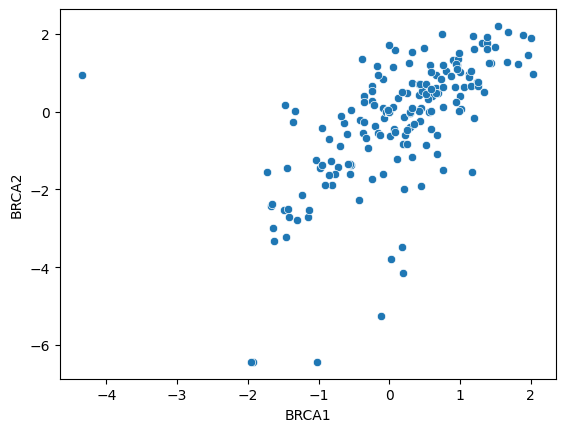

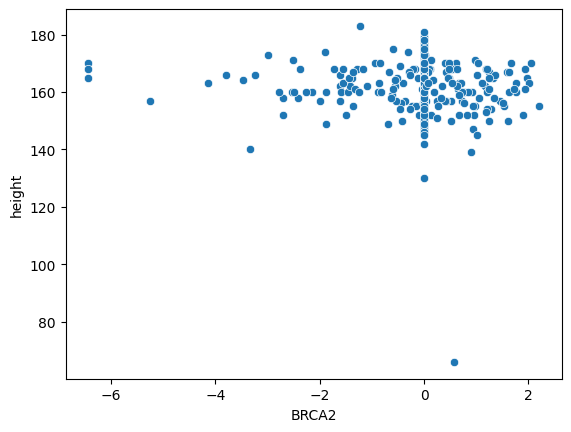

In [9]:
sns.scatterplot(data=merged_data, x='BRCA1', y='BRCA2')
plt.show()

sns.scatterplot(data=merged_data, x='BRCA2', y=condition_col)
plt.show()

### 3. Do regression & Cross Validation

In [10]:

def replace_infinity_with_nan(data):
    """Replace infinity values with NaN."""
    return np.where(np.isinf(data), np.nan, data)

def compute_normalization_params(data):
    """Compute mean and standard deviation, handling zero standard deviation."""
    mean = np.nanmean(data, axis=0)
    std = np.nanstd(data, axis=0)
    std[std <= 1e-8] = 1  # Avoid division by zero
    return mean, std

def normalize_data(data, mean, std):
    """Normalize data using given mean and standard deviation."""
    data_normalized = np.where(np.isnan(data), 0, (data - mean) / std)
    return data_normalized

def preprocess_data(X_train, X_test=None):
    X_train = replace_infinity_with_nan(X_train)
    mean_train, std_train = compute_normalization_params(X_train)

    X_train_normalized = normalize_data(X_train, mean_train, std_train)

    if X_test is not None:
        X_test = replace_infinity_with_nan(X_test)
        X_test[:, std_train <= 1] = 0  # Set zero std columns in test data to zero
        X_test_normalized = normalize_data(X_test, mean_train, std_train)
    else:
        X_test_normalized = None

    return X_train_normalized, X_test_normalized


In [11]:
def split_data(X, y, indices, train_indices, test_indices):
    """Split data into training and testing sets based on indices."""
    X_train, X_test = X[train_indices], X[test_indices]
    y_train, y_test = y[train_indices], y[test_indices]
    return X_train, X_test, y_train, y_test

def train_and_predict(X_train, y_train, X_test):
    """Train the model and make predictions."""
    var_select = VariableSelection()
    var_select.fit(X_train, y_train)
    predictions = var_select.predict(X_test)
    return predictions

def evaluate_accuracy(predictions, y_test):
    """Evaluate the accuracy of predictions."""
    binary_predictions = (predictions > 0.5).astype(int)
    return np.mean(binary_predictions == y_test)

def cross_validation(X, y, k=5):
    indices = np.arange(X.shape[0])
    np.random.shuffle(indices)

    fold_size = len(X) // k
    accuracies = []

    for i in range(k):
        test_indices = indices[i*fold_size : (i+1)*fold_size]
        train_indices = np.setdiff1d(indices, test_indices)

        X_train, X_test, y_train, y_test = split_data(X, y, indices, train_indices, test_indices)
        X_train, X_test = preprocess_data(X_train, X_test)

        predictions = train_and_predict(X_train, y_train, X_test)
        accuracy = evaluate_accuracy(predictions, y_test)
        accuracies.append(accuracy)

    return np.mean(accuracies), np.std(accuracies)

# Select relevant columns and convert to numpy array
y = merged_data[trait].values
X = merged_data.drop(columns=[trait]).values

cv_mean, cv_std = cross_validation(X, y)
print(f'The cross-validation accuracy is {(cv_mean * 100):.2f}% ± {(cv_std * 100):.2f}%')

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sparse_lmm/helpingMethods.py:49: RuntimeWarning: invalid value encountered in divide
  ts = beta / np.sqrt(var * sigma)


The cross-validation accuracy is 91.02% ± 3.68%


In [12]:

def prepare_data(merged_data, trait):
    """Prepare and preprocess the dataset."""
    y = merged_data[trait].values
    X = merged_data.drop(columns=[trait]).values
    X, _ = preprocess_data(X)  # Assuming preprocess_data is defined elsewhere
    return X, y

def fit_model(X, y):
    """Fit the VariableSelection model to the data."""
    var_select = VariableSelection()
    var_select.fit(X, y)
    return var_select

def get_model_output(var_select):
    """Retrieve and process the model's output."""
    coefficients = var_select.getBeta().reshape(-1).tolist()
    nlog_p_values = var_select.getNegLogP().reshape(-1).tolist()
    p_values = [np.exp(-p) for p in nlog_p_values]
    return coefficients, p_values

# Main execution
X, y = prepare_data(merged_data, trait)
var_select = fit_model(X, y)
coefficients, p_values = get_model_output(var_select)

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sparse_lmm/helpingMethods.py:49: RuntimeWarning: invalid value encountered in divide
  ts = beta / np.sqrt(var * sigma)


### 4. Discussion

In [13]:
import pandas as pd
from statsmodels.stats.multitest import multipletests


# Create a DataFrame for the regression results
regression_df = pd.DataFrame({
    'Variable': feature_cols,
    'Coefficient': coefficients,
    'p_value': p_values
})

# Extract information about the lifestyle condition's effect
condition_effect = regression_df.iloc[0]

# Report the effect of the lifestyle condition
print(f"Effect of the condition on the target variable:")
print(f"Variable: {condition}")
print(f"Coefficient: {condition_effect['Coefficient']:.4f}")
print(f"p-value: {condition_effect['p_value']:.4g}\n")

Effect of the condition on the target variable:
Variable: height
Coefficient: -0.0117
p-value: 0.539



In [14]:
threshold = 0.05
# Apply the Benjamini-Hochberg correction
rejected, corrected_p_values, _, _ = multipletests(regression_df['p_value'][1:], alpha=threshold, method='fdr_bh')

# Add the corrected p-values to the DataFrame (ignoring the first row which is the condition)
regression_df.loc[1:, 'corrected_p_value'] = corrected_p_values

# Now filter based on the corrected p-values
significant_genes = regression_df.loc[(regression_df.index > 0) & (regression_df['corrected_p_value'] < threshold)]
significant_genes_sorted = significant_genes.sort_values('corrected_p_value')

# Print and/or save your results as before
print(f"Genes with corrected p-value < {threshold}, affecting the trait {trait} conditional on the factor {condition}, sorted by corrected p-value:")
print(significant_genes_sorted[['Variable', 'Coefficient', 'corrected_p_value']].to_string(index=False))
print(f"\nFound {len(significant_genes_sorted)} significant genes with corrected p-value < {threshold}")
# Save this to a CSV file
significant_genes_sorted.to_csv('significant_genes_report_corrected.csv', index=False)

Genes with corrected p-value < 0.05, affecting the trait Endometrioid Cancer conditional on the factor height, sorted by corrected p-value:
Empty DataFrame
Columns: [Variable, Coefficient, corrected_p_value]
Index: []

Found 0 significant genes with corrected p-value < 0.05
